In [1]:
"""Running basic code:
Importing packages, setting working directory, 
printing out date"""

import os as os
os.chdir('C:/Users/Falco/Desktop/directory/Missing_links_in_viral_host_communities/')
import datetime as dt
str(dt.datetime.now())
from sklearn.metrics import confusion_matrix
import seaborn as sns
from pandas_ml import ConfusionMatrix
data_path = 'C:\Users\Falco\Desktop\directory\Missing_links_in_viral_host_communities\data'
output_path = 'C:\Users\Falco\Desktop\directory\Missing_links_in_viral_host_communities\outputs'
from HPnex import functions as f
from HPnex import classification as classify
import numpy as np
import networkx as nx
#np.random.seed(42)
from sklearn.ensemble import RandomForestClassifier
from pandas_ml import ConfusionMatrix
from matplotlib import pyplot as plt
import seaborn as sns
import scipy.stats as stats
from sklearn import model_selection
height = 6
font = 12

import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfTransformer
from sklearn.ensemble import RandomForestClassifier, GradientBoostingClassifier, AdaBoostClassifier
from sklearn.naive_bayes import MultinomialNB
from sklearn.svm import SVC, LinearSVC
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
#from sklearn.cross_validation import
from sklearn.model_selection import StratifiedKFold ,cross_val_score, train_test_split, cross_val_predict
from sklearn.tree import DecisionTreeClassifier 
from sklearn.model_selection import learning_curve
from pandas_ml import ConfusionMatrix
from textblob import TextBlob
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
import itertools as itertools

# Predicting missing links in the virus host network

## Problem

We assumed that networks formed due to virus-host associations behave as social networks and evolve as and when new data is generated from surveillance efforts. **Network topology and data with respect to nodes can be useful in predicting missing (or future) associations in the network.**
  
To see if current network associations generated due to host sharing between viruses can predict future associations of recently discovered viruses, we developed a supervised machine learning model to predict missing links of virus associations developed due to sharing vertebrate host species. 

## Data
Currently we are using two datasets.  
Viral Spill database developed by EpiCenter for Disease Dynamics and HP3 database developed by EcoHealth Alliance.  
Both the databases contain zoonotic and non-zoonotic viruses found in mammalian and avian species. Dataset describes species and test used for detection of virus in the species.   
1. We are using virus host associations detected with a test higher than a medium detection quality presented in the HP3 dataset.  
2. For known zoonotic viruses, we include additional host virus association with *Homo sapiens* as host species.  

In [2]:
import pandas as pd
data = pd.read_pickle(data_path + '\species_hp_updated.pickle')
data['Virus'] = data.virus_name
data = data[data.ScientificName != 'Pelophylax ridibundus'];
data = data[data.ScientificName != 'Crocodylus moreletii']
data = data[data.ScientificName != 'unknown unknown']
data = data[data.ScientificName != 'Anaxyrus fowleri']
data = data[data.ScientificName != 'spp.']
data = data[data.ScientificName != '']
data = data[data.ScientificName != 'Sturnidae']
data = data[data.ScientificName != 'Apodemus']
data.replace('Gis Glis', 'Glis glis', inplace= True)
data.replace('Murina  aurata', 'Murina aurata', inplace= True)
data.replace('Liomys adspersus', 'Heteromys adspersus', inplace= True)
data.replace('Oreothlypis ruficapilla', 'Vermivora ruficapilla', inplace= True)
data.replace('Streptopelia chinensis', 'Spilopelia chinensis', inplace= True)
data.replace('Haemorhous mexicanus', 'Carpodacus mexicanus', inplace= True)
data.replace('Pseudalopex vetulus', 'Lycalopex vetulus', inplace= True)
data.replace('Sigmondon toltecus', 'Sigmodon toltecus', inplace= True)
data.replace('Milvago chimango', 'Milvago chimachima', inplace= True)
data.replace('Spinus tristis', 'Carduelis tristis', inplace= True)
data.replace('Alopex lagopus', 'Vulpes lagopus', inplace= True)
data.replace('Clethrionomys rufocanus', 'Myodes rufocanus', inplace= True)
data.replace('Ichthyaetus leucophthalmus', 'Larus leucophthalmus', inplace= True)
data.replace('Pan troglodyte', 'Pan troglodytes', inplace= True)
data.replace('Poecile atricapillus', 'Parus atricapillus', inplace= True)
data.replace('Poecile carolinensis', 'Parus carolinensis', inplace= True)
data.replace('Erythacus rubecula', 'Erithacus rubecula', inplace= True)
data.replace('Micoureus demerarae', 'Marmosa demerarae', inplace= True)
#data.replace('', '', inplace= True)


In [3]:
data['virus_name_old'] = data.virus_name
data['virus_name'] = data.species
data['VF'] = data.iloc[:,[19]]
data.drop('viral_family', axis=1, inplace= True)
data['viral_family'] = data['VF']
data.columns.get_loc('viral_family')
data.viral_family.fillna('Not_Assinged', inplace= True)

In [4]:
data.head()

,DetectionQuality,ScientificName,Source,Virus,Virus_Confirmed,Wild,accession,common_names,domestic,host_family,...,hits,hits_ln,number_of_hosts,order,species,tax_id,tax_id_n,virus_name_old,VF,viral_family
0,NaN,Accipiter cooperii,EpiCenter,West Nile virus,1,NaN,0,nan,nan,Accipitridae,...,21421.0,9.972127,1126.0,NaN,West Nile virus,11082.0,11082.0,West Nile virus,Flaviviridae,Flaviviridae
1,NaN,Accipiter cooperii,EpiCenter,West Nile virus,1,NaN,AF206520,nan,nan,Accipitridae,...,21421.0,9.972127,1126.0,NaN,West Nile virus,11082.0,11082.0,West Nile virus,Flaviviridae,Flaviviridae
2,NaN,Accipiter cooperii,EpiCenter,West Nile virus,1,NaN,HM756660,nan,nan,Accipitridae,...,21421.0,9.972127,1126.0,NaN,West Nile virus,11082.0,11082.0,West Nile virus,Flaviviridae,Flaviviridae
3,NaN,Accipiter gentilis,EpiCenter,West Nile virus,1,NaN,GU566739,nan,nan,Accipitridae,...,21421.0,9.972127,1126.0,NaN,West Nile virus,11082.0,11082.0,West Nile virus,Flaviviridae,Flaviviridae
4,NaN,Accipiter gentilis,EpiCenter,West Nile virus,1,NaN,HM015884,nan,nan,Accipitridae,...,21421.0,9.972127,1126.0,NaN,West Nile virus,11082.0,11082.0,West Nile virus,Flaviviridae,Flaviviridae


In [5]:
virus_df = data.groupby(
    ['virus_name', 'viral_family',
     'PubMed_Search_ln']).size().reset_index()
virus_df['group'] = np.random.randint(1, 6, virus_df.shape[0])
virus_df['group'].value_counts()
virus_df.head()

,virus_name,viral_family,PubMed_Search_ln,0,group
0,Adelaide River ephemerovirus,Rhabdoviridae,2.079567,1,3
1,Adeno-associated dependoparvovirus A,Parvoviridae,5.505336,1,3
2,Adeno-associated dependoparvovirus B,Parvoviridae,2.484990,1,3
3,African green monkey polyomavirus,Not_Assinged,0.693647,1,2
4,African swine fever virus,Asfarviridae,6.854356,3,1


In [6]:
data_species_list = set(data.ScientificName.unique().tolist())
IUCN = pd.read_csv(data_path+ '\IUCN Mammals, Birds, Reptiles, and Amphibians.csv',)
IUCN["ScientificName"] = IUCN["Genus"].map(str) +' '+IUCN["Species"]
IUCN_list = set(IUCN.ScientificName.unique().tolist())
missing_names = list(data_species_list.difference(IUCN_list))
missing_names
#pd.DataFrame({'ScientificName': missing_names}).to_csv('C:\Users\Falco\Desktop\directory\Link_Prediction\outputs\missing_names.csv')

[]

In [7]:
df = pd.merge(
    data, virus_df[['virus_name', 'group']], on='virus_name', how='left')

# Prediction problem and generation of networks for prediction 

A mono-partite network of viruses was generated, where viruses are nodes and edges between viruses are common hosts they are associated with $G = (V, E)$, where each edge, $e = (u, v) \in E$ represents a vertebrate hosts between virus *u* and *v*.


We assumed that the complete network of known hosts of viruses *G<sub>c </sub>* is formed by two parts.  
1. an observed *G<sub>o </sub>* network and 
2. an unobserved *G<sub>u </sub>* part of the network.

We chose all the pairs of viruses which are **not connected in *G<sub>o </sub>*** and labeled them positive (1) if the nodes are connected in *G<sub>c </sub>*, and negative (0)if they are not connected.   
For each pair we calculated set of network topology features from using the *G<sub>o </sub>* network.  

## Complete network *G<sub>c </sub>*

This is the complete network and will be utilized to generate labels (output variable) for missing links

In [8]:
len(df.host_genus.unique())

490

In [9]:
len(df.ScientificName.unique())

950

In [10]:
%%time
Gc_df, Gc = f.construct_unipartite_virus_virus_network(
    dataframe=df,
    network_name='all_network',
    layout_func='fruchterman_reingold',
    plot=True,
    filter_file=False,
    taxonomic_filter=None,
    return_df=True)
nx.write_graphml(Gc,'C:/Users/Falco/Desktop/directory/Missing_links_in_viral_host_communities/outputs/Complete_Networks/Host_level_C.graphml')


we have 136503 virus pairs in our model


Loading BokehJS ...

Wall time: 1min 57s


In [11]:
%%time
print('Network Saved, calculating features')
Gc_data = f.calculate_features(data_frame=Gc_df, network= Gc, 
                               Species_file_name =  '\IUCN Mammals, Birds, Reptiles, and Amphibians.csv',
                               data_path = data_path, virus_df = virus_df)

Network Saved, calculating features
calculate_features function is in function file 1st function
calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating node clusters
calculating if nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits
(171320, 22)
Wall time: 8min 52s


## Generation of observed Network *G<sub>o </sub>*

We randomly removed 20% of the nodes in the *G<sub>c </sub>* to generate *G<sub>o </sub>* 

This forms a hypothetical network G<sub>o </sub>, which we assumed is the current status of our information on host sharing between viruses. Future investigations would reveal a complete picture of the network G<sub>c </sub>.    

In [12]:
import random as random
print('we have ' + str(len(Gc.edges)) + ' edges in complete network')
## randomly assigning groups to all edges to remove
for u, v in Gc.edges():
    Gc[u][v]['remove_group'] = random.randint(1, 6)
## Copying Gc to Go
Go = Gc.copy()
# remove group 1
ebunch = ((u, v) for u, v, d in Go.edges(data=True) if d['remove_group'] == 1)
Go.remove_edges_from(ebunch)
print('we have ' + str(len(Go.edges)) + ' edges in observed network')

we have 35838 edges in complete network
we have 29806 edges in observed network


### Generating feature data and model data for observed network *G<sub>o </sub>*
1. Generate a bipartite network of complete data with host and viruses for filling host names and number of hosts between two viruses.
2. Generated list of viruses in the observed network *G<sub>o </sub>*
3. combinations of virus pairs using viruses in *G<sub>o </sub>*
4. for each of those virus pairs we generated a list of shared hosts and names of shared hosts from the complete data, showing the true status of those pairs in complete network (*G<sub>c </sub>*)
5. We generated a data frame of virus pairs (edges) which are randomly removed from the complete network *G<sub>c </sub>* (ebunch) and assigned values of zero to forcefully generate pairs with no sharing of viruses 
6. Merged those two dataframes to develop a complete dataframe with all possible edges between viruses with pairs of viruses randomly assigned zero value.  
7. for all these pairs (edges) network characteristics features from observed network (*G<sub>o </sub>*) were calculated. 
8. Labels (output) were generated only for edges which are not sharing hosts in observed  network(*G<sub>o </sub>*) as follows. If edge (virus pair) was shown to share host in n_shared_host (*G<sub>c </sub>*) but not in shared_host (*G<sub>o </sub>*) then it got a positive label, else they got a negative label. 


In [13]:
IUCN = pd.read_csv(data_path+ '\IUCN Mammals, Birds, Reptiles, and Amphibians.csv',)
IUCN["ScientificName"] = IUCN["Genus"].map(str) +' '+IUCN["Species"]
"""STEP 1"""
"""first construct bipartite network to reterive original data information about shared hosts"""
BPnx = f.construct_bipartite_host_virus_network(
    dataframe=df,
    network_name='Go',
    plot=False,
    filter_file=False,
    taxonomic_filter=None)
"""STEP 2"""
vlist = list(Go.nodes())
"""STEP 3"""
d = pd.DataFrame(list(itertools.combinations(vlist, 2)))
d.columns = ['Virus1', 'Virus2']
"""STEP 4"""


def get_n_shared_hosts(c):
    return len(list(nx.common_neighbors(BPnx, c['Virus1'], c['Virus2'])))


d['n_shared_hosts_c'] = d.apply(get_n_shared_hosts, axis=1)


def addsharedhosts(c):
    return sorted(nx.common_neighbors(BPnx, c['Virus1'], c['Virus2']))


d["shared_hosts_c"] = d.apply(addsharedhosts, axis=1)
print ('getting Order and Family values for shared hosts')
def getOrders (c):
    orderlist = []
    if len(c.shared_hosts_c) > 0:
        for h in (c.shared_hosts_c):
            try:
                orderlist.append(IUCN.loc[IUCN['ScientificName'] == h, 'Order'].iloc[0])
            except:
                orderlist.append('MatchNotFound')
    return orderlist
d['orders_label'] = d.apply(getOrders, axis=1)

"""STEP 5"""
ebunch = ((u, v) for u, v, d in Gc.edges(data=True) if d['remove_group'] == 1)
to_remove = pd.DataFrame(list(ebunch))
to_remove.columns = ['Virus1', 'Virus2']
to_remove['n_shared_hosts'] = 0
to_remove['shared_hosts'] = [list() for x in range(len(to_remove.index))]
"""STEP 6"""
m = pd.merge(d, to_remove, on=['Virus1', 'Virus2'], how='left')
m.n_shared_hosts.fillna(m.n_shared_hosts_c, inplace=True)
m.shared_hosts.fillna(m.shared_hosts_c, inplace=True)
m[(m.Virus1 == 'Mopeia virus')
  & (m.Virus2 == 'Western equine encephalitis virus')]

getting Order and Family values for shared hosts


,Virus1,Virus2,n_shared_hosts_c,shared_hosts_c,orders_label,n_shared_hosts,shared_hosts


In [14]:
%%time
"""STEP 7"""
Go_data = f.calculate_features(
    data_frame=m,
    network=Go,
    Species_file_name='\IUCN Mammals, Birds, Reptiles, and Amphibians.csv',
    data_path=data_path,
    virus_df=virus_df)

calculate_features function is in function file 1st function
calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating node clusters
calculating if nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits
(171320, 25)
Wall time: 5min 5s


In [15]:
"""STEP 8"""
model_data = Go_data[Go_data.n_shared_hosts == 0]
model_data['label'] = np.where(model_data['n_shared_hosts_c']>0, 1, 0)

C:\Users\Falco\Anaconda2\lib\site-packages\ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [16]:
model_data['PubMedSeach_sum'] = model_data.PubMed_Search_ln1 + model_data.PubMed_Search_ln2

C:\Users\Falco\Anaconda2\lib\site-packages\ipykernel_launcher.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  """Entry point for launching an IPython kernel.


#### Correlations between predictors 

In [37]:
model_data.columns.tolist()

['Virus1',
 'Virus2',
 'n_shared_hosts_c',
 'shared_hosts_c',
 'orders_label',
 'n_shared_hosts',
 'shared_hosts',
 'jaccard',
 'hasPath',
 'ShortPathLen',
 'adamic_adar',
 'resource',
 'preferential_attach',
 'betweeness_diff',
 'VirusCluster1',
 'VirusCluster2',
 'in_same_cluster',
 'degree_diff',
 'ViralFamily1',
 'ViralFamily2',
 'PubMed_Search_ln1',
 'PubMed_Search_ln2',
 'FamilyMatch',
 'PubMed_diff',
 'Link',
 'label',
 'PubMedSeach_sum']

In [38]:
o_path = 'C:/Users/Falco/Desktop/directory/Missing_links_in_viral_host_communities/outputs/'

C:\Users\Falco\Anaconda2\lib\site-packages\seaborn\axisgrid.py:1847: UserWarning: JointGrid annotation is deprecated and will be removed in a future release.
  warnings.warn(UserWarning(msg))


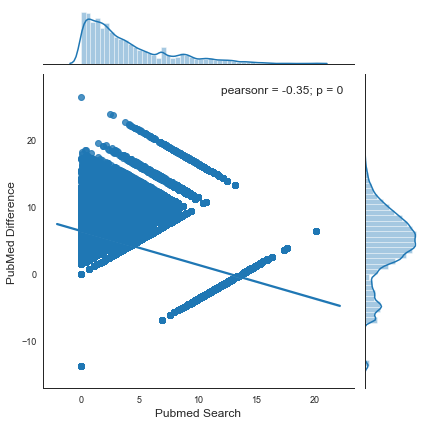

In [17]:
g = sns.jointplot(
    x="PubMed_diff", y="PubMedSeach_sum", data=model_data, kind='reg', height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Pubmed Search', ylabel='PubMed Difference', fontsize=font)
plt.show()

ValueError: Could not interpret input 'neighbors_n'

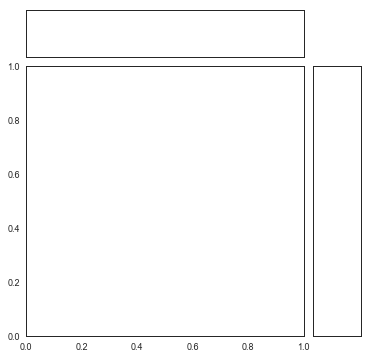

In [18]:
g = sns.jointplot(
    x="jaccard", y="neighbors_n", data=model_data, kind='reg', height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Jaccard', ylabel='Number of Neighbours', fontsize=font)
plt.show()

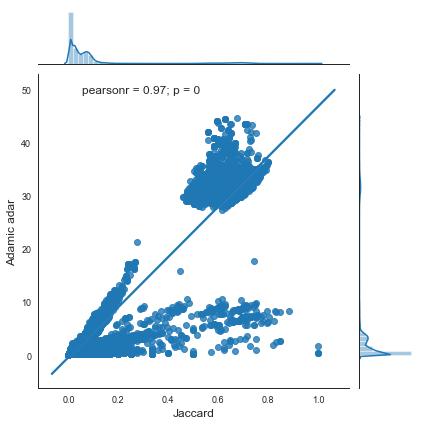

In [39]:
g = sns.jointplot(
    x="jaccard", 
    y="adamic_adar",
    data=model_data, 
    kind='reg', 
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Jaccard',
    ylabel='Adamic adar',
    fontsize=font)
plt.savefig(o_path+'/jaccard_vs_adamic.png', dpi = 600, figsize= [8,8])
plt.show()

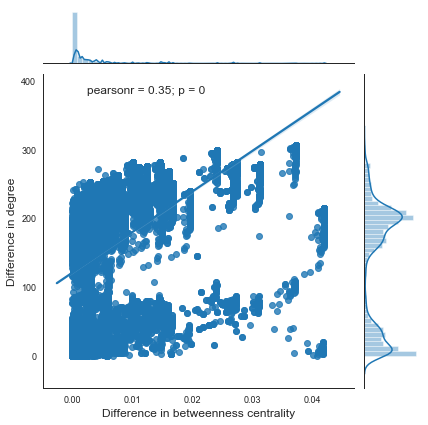

In [40]:
g = sns.jointplot(
    x="betweeness_diff",
    y="degree_diff",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Difference in betweenness centrality',
    ylabel='Difference in degree',
    fontsize=font)
plt.savefig(o_path+'/diif_degree_vs_between.png', dpi = 600, figsize= [8,8])
plt.show()

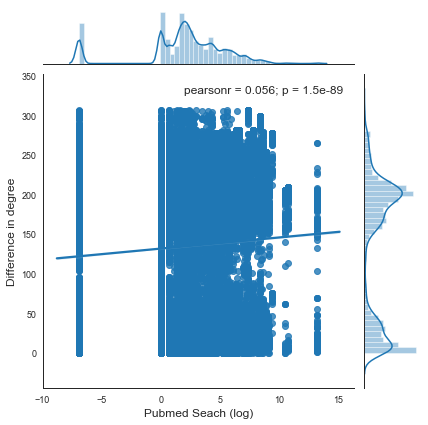

In [21]:
g = sns.jointplot(
    x="PubMed_Search_ln1",
    y="degree_diff",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Pubmed Seach (log)', 
    ylabel='Difference in degree', 
    fontsize=font)

plt.show()

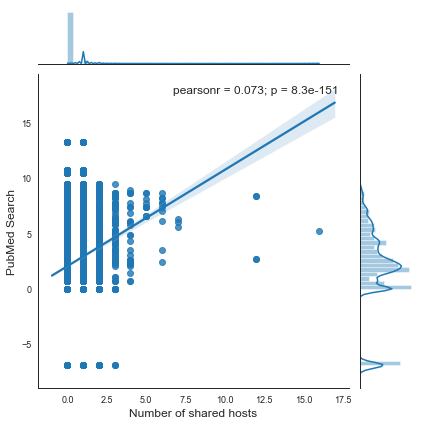

In [22]:
g = sns.jointplot(
    x="n_shared_hosts_c",
    y="PubMed_Search_ln1",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Number of shared hosts', 
    ylabel='PubMed Search',
    fontsize=font)
plt.show()

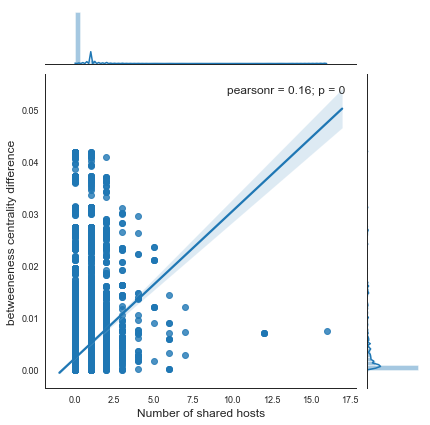

In [23]:
g = sns.jointplot(
    x="n_shared_hosts_c",
    y="betweeness_diff",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Number of shared hosts',
    ylabel='betweeneness centrality difference',
    fontsize=font)
plt.show()

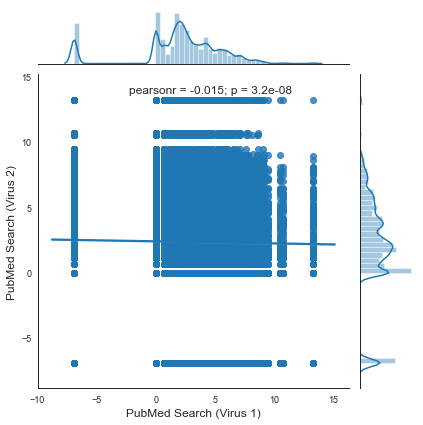

In [41]:
g = sns.jointplot(
    x="PubMed_Search_ln1",
    y="PubMed_Search_ln2",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(
    stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='PubMed Search (Virus 1)', 
    ylabel='PubMed Search (Virus 2)', fontsize=font)

plt.savefig(o_path+'/PubMedV1_vs_PubMedV2.png', dpi = 600, figsize= [8,8])
plt.show()

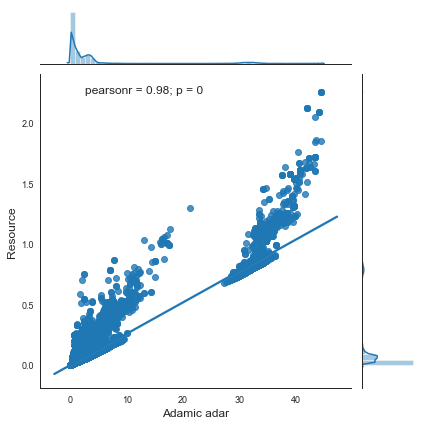

In [42]:
g = sns.jointplot(
    x="adamic_adar",
    y="resource",
    data=model_data,
    kind='reg', 
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Adamic adar', ylabel='Resource', fontsize=font)
plt.savefig(o_path+'/Adamic_vs_Resource.png', dpi = 600, figsize= [8,8])
plt.show()

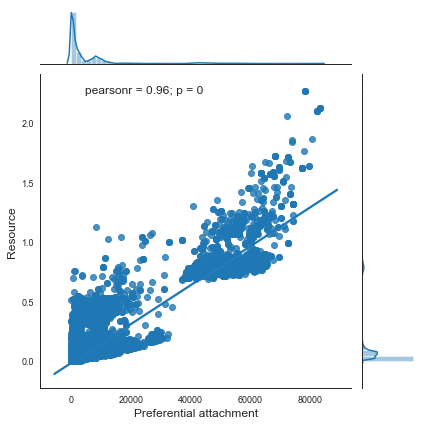

In [43]:
g = sns.jointplot(
    x="preferential_attach",
    y="resource",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Preferential attachment', ylabel='Resource', fontsize=font)
plt.savefig(o_path+'/PrefAttch_vs_Resource.png', dpi = 600, figsize= [8,8])
plt.show()

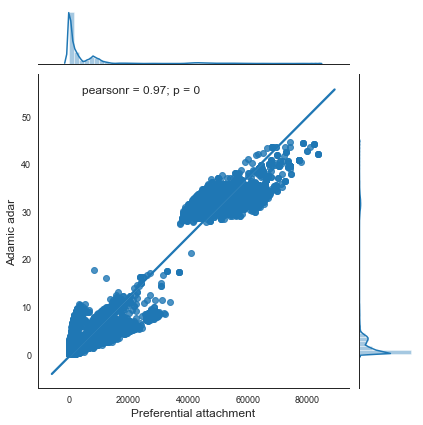

In [44]:
g = sns.jointplot(
    x="preferential_attach",
    y="adamic_adar",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='Preferential attachment', ylabel='Adamic adar', fontsize=font)
plt.savefig(o_path+'/Adamic_vs_PrefAttach.png', dpi = 600, figsize= [8,8])
plt.show()

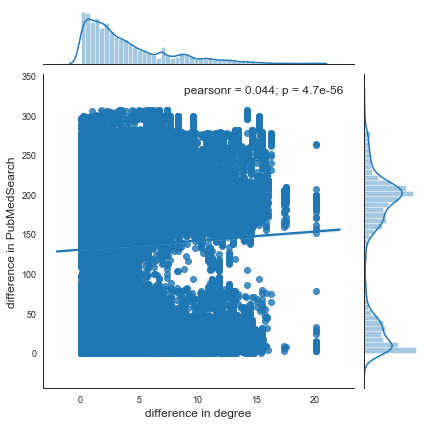

In [45]:
g = sns.jointplot(
    x="PubMed_diff",
    y="degree_diff",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='difference in degree',
    ylabel='difference in PubMedSearch',
    fontsize=font)
plt.savefig(o_path+'/DegreeDiff_vs_PubMedDiff.png', dpi = 600, figsize= [8,8])
plt.show()

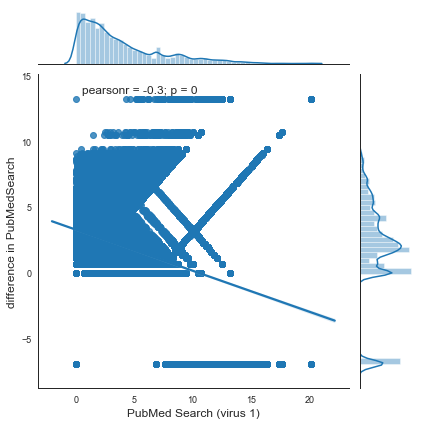

In [29]:
g = sns.jointplot(
    x="PubMed_diff",
    y="PubMed_Search_ln1",
    data=model_data,
    kind='reg',
    height=height)
g = g.annotate(stats.pearsonr, fontsize=font)
g.set_axis_labels(
    xlabel='PubMed Search (virus 1)',
    ylabel='difference in PubMedSearch',
    fontsize=font)
plt.show()

##### Correlations with presence of link between two nodes

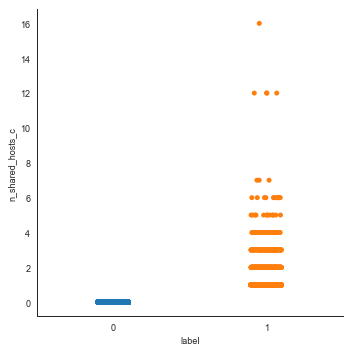

In [30]:
g = sns.catplot(x="label", y="n_shared_hosts_c",  data=model_data); plt.show()

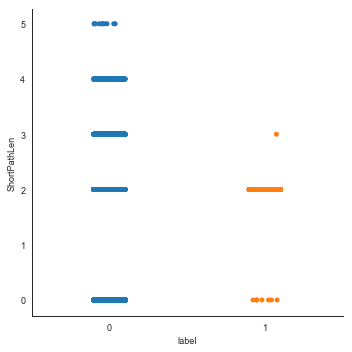

In [31]:
g = sns.catplot(x="label", y="ShortPathLen",  data=model_data);plt.show()

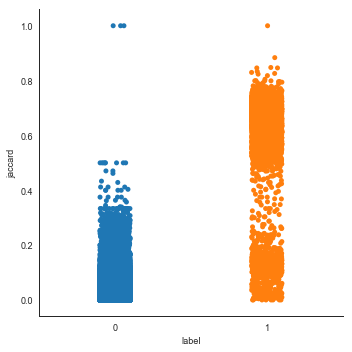

In [32]:
g = sns.catplot(x="label", y="jaccard",  data=model_data);

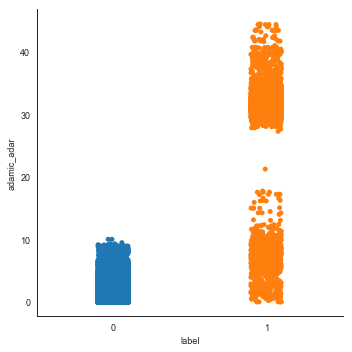

In [33]:
g = sns.catplot(x="label", y="adamic_adar",  data=model_data);

In [34]:
model_data.groupby(["label", "hasPath"])['Virus1'].count().unstack().fillna(0)

hasPath,0,1
label,,
0,15986,103721
1,7,7675


In [35]:
model_data.groupby(["label", "in_same_cluster"])['Virus1'].count().unstack()

in_same_cluster,0,1
label,,
0,105680,14027
1,3873,3809


In [36]:
model_data.groupby(["label", "FamilyMatch"])['Virus1'].count().unstack()

FamilyMatch,0,1
label,,
0,113218,6489
1,7186,496


In [ ]:
from sklearn.linear_model import SGDClassifier
from sklearn.ensemble import ExtraTreesClassifier, RandomForestClassifier, AdaBoostClassifier, GradientBoostingClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score
from sklearn.svm import SVC, LinearSVC
from sklearn import preprocessing
from sklearn_pandas import DataFrameMapper
from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix

## Preprocessing predictors for model

1. Converting categorical variables into numeric codes
2. Standard Scaling of continuous variables

In [ ]:
predictors = [
    'jaccard', 'betweeness_diff', 'in_same_cluster', 'degree_diff',
    'FamilyMatch', 'PubMed_diff', 'PubMed_Search_ln1', 'PubMed_Search_ln2'
]
# datasets for sklearn
Y = model_data["label"].values
X = model_data[list(predictors)].values
#### Standardize X
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_std = scaler.fit_transform(X)
data_processed = pd.DataFrame(X_std, columns=predictors)
#data_processed.head()

In [ ]:
le = preprocessing.LabelEncoder()
le.fit(pd.unique(model_data[['ViralFamily1', 'ViralFamily2']].values.ravel('K')))
model_data['F1'] = le.transform(model_data.ViralFamily1) 
model_data['F2'] = le.transform(model_data.ViralFamily2) 
data_processed['F1'] = model_data.F1
data_processed['F2'] = model_data.F2

In [20]:
data_processed.head()

,jaccard,betweeness_diff,in_same_cluster,degree_diff,FamilyMatch,PubMed_diff,PubMed_Search_ln1,PubMed_Search_ln2,F1,F2
0,-0.460527,0.261047,-0.341402,0.838588,-0.239899,-0.695039,-0.398168,-0.077364,NaN,NaN
1,-0.460527,0.261047,-0.341402,0.872246,-0.239899,-0.602403,-0.398168,0.010883,19.0,4.0
2,-0.332979,0.242957,2.929100,0.771273,-0.239899,-0.831751,-0.398168,-0.207601,19.0,28.0
3,-0.460527,0.261047,-0.341402,0.872246,-0.239899,-0.831751,-0.398168,-0.207601,19.0,14.0
4,-0.365303,0.260916,2.929100,0.771273,-0.239899,-0.778719,-0.398168,-0.157081,19.0,14.0


In [21]:
X_std = data_processed.values

## Random Forest Classifier

### GridSearch

Cross validated grid search was done to identify best hyper-parameters for Random Forest Classifier. 
Hyper-parameters under consideration were and values tested
1. number of estimators (The number of trees in the forest) = 100, 300, 500
2. maximum features (The number of features to consider when looking for the best split) =auto, log2, sqrt
3. maximum depth (The maximum depth of the tree) = 3, 6, 10
4. criterion (The function to measure the quality of a split) = gini, entropy

\begin{equation*}
\[\frac{|\Gamma(u) \cap \Gamma(v)|}{|\Gamma(u) \cup \Gamma(v)|}\]
where \(\Gamma(u)\) denotes the set of neighbors of \(u\).
\end{equation*}

In [21]:
%%time

# Set the parameters by cross-validation
tuned_parameters = [{
    'n_estimators': [300, 400, 500, 1000],
    'max_features': ['auto', 'sqrt', 'log2'],
    'max_depth' : [None, 5,15],
    'criterion' :['gini', 'entropy'], 
    'min_samples_split': [2, 10],
    'min_samples_leaf': [1, 5, ],
}]

scores = ['precision', 'recall']

for score in scores:
    print("# Tuning hyper-parameters for %s" % score)
    print()

    clf = GridSearchCV(
        RandomForestClassifier(),
        tuned_parameters,
        cv=5,
        scoring='%s_macro' % score,
        verbose=1,
        n_jobs=1)
    clf.fit(X, Y)

    print("Best parameters set found on development set:")
    print()
    print(clf.best_params_)
    print()
    print("Grid scores on development set:")
    print()
    means = clf.cv_results_['mean_test_score']
    stds = clf.cv_results_['std_test_score']
    for mean, std, params in zip(means, stds, clf.cv_results_['params']):
        print("%0.3f (+/-%0.03f) for %r" % (mean, std * 2, params))
    print()

    print("Detailed classification report:")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print()

    Y, y_pred = Y, clf.predict(X)
    print(classification_report(Y, y_pred))
    print()

# Tuning hyper-parameters for precision
()
Fitting 5 folds for each of 288 candidates, totalling 1440 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1440 out of 1440 | elapsed: 814.1min finished


Best parameters set found on development set:
()
{'min_samples_leaf': 1, 'n_estimators': 1000, 'min_samples_split': 2, 'criterion': 'entropy', 'max_features': 'log2', 'max_depth': 5}
()
Grid scores on development set:
()
0.993 (+/-0.012) for {'min_samples_leaf': 1, 'n_estimators': 300, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.993 (+/-0.011) for {'min_samples_leaf': 1, 'n_estimators': 400, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.993 (+/-0.011) for {'min_samples_leaf': 1, 'n_estimators': 500, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.993 (+/-0.011) for {'min_samples_leaf': 1, 'n_estimators': 1000, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.993 (+/-0.009) for {'min_samples_leaf': 1, 'n_estimators': 300, 'min_samples_split': 10, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.994 (

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    108342
           1       1.00      0.94      0.97      6263

   micro avg       1.00      1.00      1.00    114605
   macro avg       1.00      0.97      0.98    114605
weighted avg       1.00      1.00      1.00    114605

()
# Tuning hyper-parameters for recall
()
Fitting 5 folds for each of 288 candidates, totalling 1440 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 1440 out of 1440 | elapsed: 789.3min finished


Best parameters set found on development set:
()
{'min_samples_leaf': 1, 'n_estimators': 500, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'log2', 'max_depth': None}
()
Grid scores on development set:
()
0.975 (+/-0.008) for {'min_samples_leaf': 1, 'n_estimators': 300, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.975 (+/-0.008) for {'min_samples_leaf': 1, 'n_estimators': 400, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.975 (+/-0.009) for {'min_samples_leaf': 1, 'n_estimators': 500, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.975 (+/-0.009) for {'min_samples_leaf': 1, 'n_estimators': 1000, 'min_samples_split': 2, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.975 (+/-0.009) for {'min_samples_leaf': 1, 'n_estimators': 300, 'min_samples_split': 10, 'criterion': 'gini', 'max_features': 'auto', 'max_depth': None}
0.975 (+

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    108342
           1       1.00      1.00      1.00      6263

   micro avg       1.00      1.00      1.00    114605
   macro avg       1.00      1.00      1.00    114605
weighted avg       1.00      1.00      1.00    114605

()
Wall time: 1d 2h 45min 22s


Best performing model parameters

In [22]:
clf.best_estimator_

RandomForestClassifier(bootstrap=True, class_weight=None, criterion='gini',
            max_depth=None, max_features='log2', max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, n_estimators=500, n_jobs=None,
            oob_score=False, random_state=None, verbose=0,
            warm_start=False)

## XGBoost Classifier 

In [24]:
%%time

from xgboost import XGBClassifier

tuned_parameters = {"learning_rate"    : [0.05, 0.10, 0.20, 0.30 ] ,
               "max_depth"        : [ 3, 4, 8, 12, 15],
               "min_child_weight" : [ 1, 3, 5, 7 ],
               "gamma"            : [ 0.0, 0.1, 0.3, 0.5 ],
               "colsample_bytree" : [ 0.3, 0.5 , 0.7 ] }


scores = ['precision', 'recall']

for score in scores:
    print("# Tuning hyper-parameters for %s" % score)
    print()

    clf = GridSearchCV(
        XGBClassifier(),
        tuned_parameters,
        cv=5,
        scoring='%s_macro' % score,
        verbose=1,
        n_jobs=1)
    clf.fit(X, Y)

    print("Best parameters set found on development set:")
    print()
    print(clf.best_params_)
    print()
    print("Grid scores on development set:")
    print()
    means = clf.cv_results_['mean_test_score']
    stds = clf.cv_results_['std_test_score']
    for mean, std, params in zip(means, stds, clf.cv_results_['params']):
        print("%0.3f (+/-%0.03f) for %r" % (mean, std * 2, params))
    print()

    print("Detailed classification report:")
    print()
    print("The model is trained on the full development set.")
    print("The scores are computed on the full evaluation set.")
    print()

    Y, y_pred = Y, clf.predict(X)
    print(classification_report(Y, y_pred))
    print()

# Tuning hyper-parameters for precision
()
Fitting 5 folds for each of 960 candidates, totalling 4800 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 4800 out of 4800 | elapsed: 283.4min finished


Best parameters set found on development set:
()
{'learning_rate': 0.1, 'colsample_bytree': 0.7, 'max_depth': 3, 'gamma': 0.5, 'min_child_weight': 1}
()
Grid scores on development set:
()
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 1}
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 3}
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 5}
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 7}
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 4, 'gamma': 0.0, 'min_child_weight': 1}
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 4, 'gamma': 0.0, 'min_child_weight': 3}
0.994 (+/-0.006) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    108342
           1       1.00      0.95      0.97      6263

   micro avg       1.00      1.00      1.00    114605
   macro avg       1.00      0.98      0.99    114605
weighted avg       1.00      1.00      1.00    114605

()
# Tuning hyper-parameters for recall
()
Fitting 5 folds for each of 960 candidates, totalling 4800 fits


[Parallel(n_jobs=1)]: Using backend SequentialBackend with 1 concurrent workers.
[Parallel(n_jobs=1)]: Done 4800 out of 4800 | elapsed: 291.5min finished


Best parameters set found on development set:
()
{'learning_rate': 0.2, 'colsample_bytree': 0.7, 'max_depth': 12, 'gamma': 0.1, 'min_child_weight': 3}
()
Grid scores on development set:
()
0.943 (+/-0.009) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 1}
0.943 (+/-0.009) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 3}
0.943 (+/-0.008) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 5}
0.943 (+/-0.009) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 3, 'gamma': 0.0, 'min_child_weight': 7}
0.944 (+/-0.008) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 4, 'gamma': 0.0, 'min_child_weight': 1}
0.944 (+/-0.008) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'max_depth': 4, 'gamma': 0.0, 'min_child_weight': 3}
0.944 (+/-0.008) for {'learning_rate': 0.05, 'colsample_bytree': 0.3, 'ma

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    108342
           1       1.00      0.99      1.00      6263

   micro avg       1.00      1.00      1.00    114605
   macro avg       1.00      1.00      1.00    114605
weighted avg       1.00      1.00      1.00    114605

()
Wall time: 9h 35min 9s


In [25]:
clf.best_estimator_

XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.7, gamma=0.1, learning_rate=0.2,
       max_delta_step=0, max_depth=12, min_child_weight=3, missing=None,
       n_estimators=100, n_jobs=1, nthread=None,
       objective='binary:logistic', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, seed=None, silent=True,
       subsample=1)

## Running Cross validation
#### Running the model with best parameters

Accuracy of model on cross validation dataset while training
Accuracy: 0.995786 (+/- 0.002381)
accuracy 0.9957855241917892

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    108342
           1       1.00      0.93      0.96      6263

   micro avg       1.00      1.00      1.00    114605
   macro avg       1.00      0.96      0.98    114605
weighted avg       1.00      1.00      1.00    114605



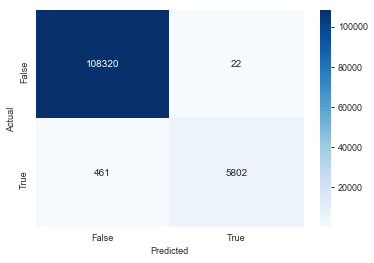

Wall time: 25min 27s


In [28]:
%%time
cv = 10
rf = RandomForestClassifier(
    bootstrap=True,
    class_weight=None,
    criterion='gini',
    max_depth=10,
    max_features='log2',
    max_leaf_nodes=None,
    min_impurity_decrease=0.0,
    min_impurity_split=None,
    min_samples_leaf=1,
    min_samples_split=2,
    min_weight_fraction_leaf=0.0,
    n_estimators=500,
    n_jobs=1,
    oob_score=False,
    random_state=42,
    verbose=1,
    warm_start=False)
best_rf = RandomForestClassifier(min_samples_leaf =  1, n_estimators= 1000, min_samples_split= 2,
                                 criterion= 'entropy', max_features= 'log2', max_depth= 5,
                                 random_state=42,verbose=0,warm_start=False)

scores = cross_val_score(best_rf, data_processed.fillna(0), Y, cv=cv)
print('Accuracy of model on cross validation dataset while training')
print("Accuracy: %0.6f (+/- %0.6f)" % (scores.mean(), scores.std() * 2))
y_pred = cross_val_predict(best_rf, data_processed.fillna(0), Y, cv=cv)

print 'accuracy', accuracy_score(Y, y_pred)
print(
    '\nprecision = positive predictive value\nrecall = sensitivity\nf-1 Score = harmonic average of precision and racall\nsupport  = n\n'
)
print classification_report(Y, y_pred)
confusion_matrix = ConfusionMatrix(Y, y_pred)
confusion_matrix.plot(
    backend='seaborn', normalized=False, cmap='Blues', annot=True, fmt='d')
plt.show()

## Random generation of observed network '*G<sub>o </sub>*'

   We randomly generated *G<sub>o </sub>* network by randomly removing edges in *G<sub>c </sub>*. Five randomly generated *G<sub>o </sub>* s were created in such a way that all the edges in the *G<sub>c </sub>* are removed from the network once and are part of the modeling data.   
  
   Data from all the virus pairs that are not connected by an edge in *G<sub>o </sub>* was used as training dataset to train if they share edge in *G<sub>c </sub>* using the Random forest classifier with best performing parameters. Each time the model was  cross validated using ten fold cross validation.  

In [12]:
from numpy import random
for u, v in Gc.edges():
    Gc[u][v]['remove_group'] = random.randint(1, 6)
"""Function to generate model data by randomly removing edges from complete network to form Go
return network dataframe ready to go into model prepropcessing"""


'Function to generate model data by randomly removing edges from complete network to form Go\nreturn network dataframe ready to go into model prepropcessing'

# Validation

## Final cross-validation of Random forest

1
we have 34099 edges in complete network
we have 28374 edges in observed network 1
Observed network 1


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'



HPnex\functions.py:859: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  model_data['label'] = np.where(model_data['n_shared_hosts_c'] > 0, 1, 0)
HPnex\functions.py:861: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  'PubMedSeach_sum'] = model_data.PubMed_Search_ln1 + model_data.PubMed_Search_ln2



Accuracy of model on cross validation dataset while training
Accuracy: 0.995194 (+/- 0.001923)
accuracy 0.9951938593048105

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    108342
           1       1.00      0.92      0.95      6303

   micro avg       1.00      1.00      1.00    114645
   macro avg       1.00      0.96      0.98    114645
weighted avg       1.00      1.00      1.00    114645



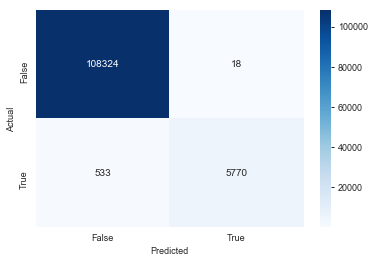

2
we have 34099 edges in complete network
we have 28430 edges in observed network 2
Observed network 2


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.995192 (+/- 0.002054)
accuracy 0.995192433536048

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
sup

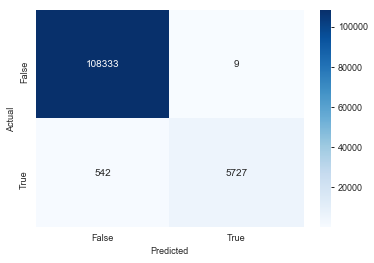

3
we have 34099 edges in complete network
we have 28330 edges in observed network 3
Observed network 3


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.996010 (+/- 0.002241)
accuracy 0.9960097577975257

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
su

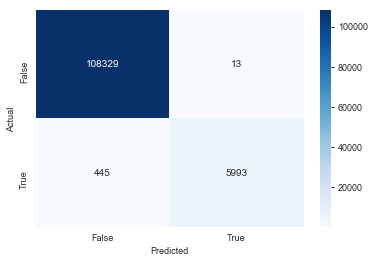

4
we have 34099 edges in complete network
we have 28442 edges in observed network 4
Observed network 4


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.994991 (+/- 0.002499)
accuracy 0.994991099165765

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
sup

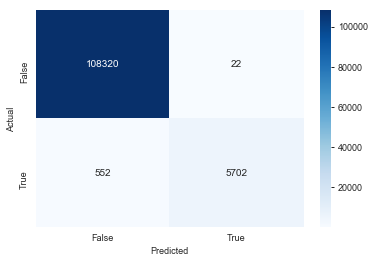

5
we have 34099 edges in complete network
we have 28502 edges in observed network 5
Observed network 5


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.995244 (+/- 0.002790)
accuracy 0.9952440375939193

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
su

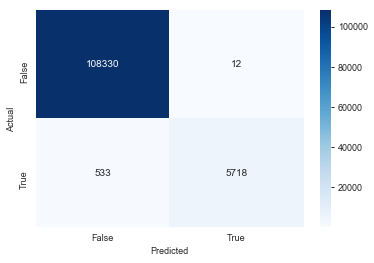

Wall time: 2h 43min 34s


In [19]:
%%time
best_rf = RandomForestClassifier(bootstrap=True, class_weight=None,criterion='gini', max_depth=10,max_features='log2',
                                 max_leaf_nodes=None,min_impurity_decrease=0.0,min_impurity_split=None,min_samples_leaf=1,
                                 min_samples_split=2,min_weight_fraction_leaf=0.0,n_estimators=500,n_jobs=1,oob_score=False,
                                 random_state=42,verbose=0,warm_start=False)
best_rf = RandomForestClassifier(min_samples_leaf =  1, n_estimators= 1000, min_samples_split= 2,
                                 criterion= 'entropy', max_features= 'log2', max_depth= 5,
                                 random_state=42,verbose=0,warm_start=False)

OutputData = []; SCORES = []; CONFUSION = []; CRs = []
for i in range (1,6):
    print i
    m1 = f.get_observed_network_data(Gc = Gc, i= i, BPnx = BPnx, data_path= data_path, 
                                   virus_df = virus_df, Species_file_name='\IUCN Mammals, Birds, Reptiles, and Amphibians.csv')
    p1, SC, CM, CR = classify.run_classification_model(model_data = m1, cv = 10 , rf = best_rf, virus_df= virus_df)
    name = 'Prediction_'+str(i)
    p1.rename(index=str, columns={"Prediction": name})
    OutputData.append(p1)
    SCORES.append(SC)
    CONFUSION.append(CM)
    CRs.append(CR)

In [20]:
SCORES

[array([0.995116  , 0.99607535, 0.99398168, 0.9938067 , 0.99537683,
        0.99537683, 0.99651082, 0.99502791, 0.99406839, 0.99659805]),
 array([0.99476531, 0.99642296, 0.99415409, 0.99459035, 0.99528837,
        0.99485211, 0.9965099 , 0.99415409, 0.99415409, 0.99703316]),
 array([0.99634114, 0.99651538, 0.99477261, 0.99529535, 0.99642795,
        0.99581809, 0.99790904, 0.99442412, 0.99494641, 0.99764747]),
 array([0.99598639, 0.99589914, 0.99397906, 0.9943281 , 0.99511301,
        0.99528755, 0.99554935, 0.99275679, 0.99371673, 0.9972947 ]),
 array([0.99537562, 0.99528796, 0.99537481, 0.99188411, 0.99572389,
        0.99668383, 0.99415307, 0.99650929, 0.99458941, 0.99685836])]

## Overall assessment of nested cross validation of out model

### Accuracy

C:\Users\Falco\Anaconda2\lib\site-packages\scipy\stats\stats.py:1713: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return np.add.reduce(sorted[indexer] * weights, axis=axis) / sumval


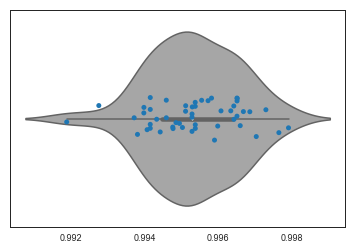

In [21]:
path  = list(itertools.chain(*SCORES))
ax = sns.violinplot(path, color=".65")
ax = sns.stripplot(path, jitter=True)

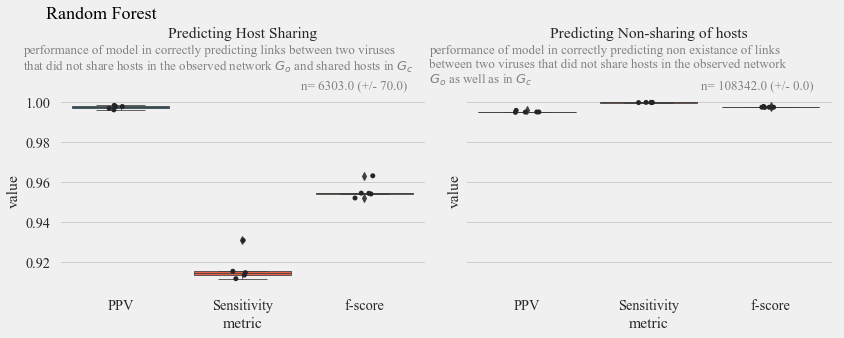

In [51]:
import matplotlib.style as style
style.use('fivethirtyeight')
plt.rcParams['font.family'] = 'Times New Roman'
sns.set_context("notebook", font_scale=1.30, rc={"lines.linewidth": 0.8})
ppv = [c[0][1] for c in CRs]
sensitivity = [c[1][1] for c in CRs]
f_score = [c[2][1] for c in CRs]
metrics = pd.DataFrame({'PPV':ppv, 'Sensitivity': sensitivity, 'f-score': f_score})
m = metrics.stack().reset_index()
m.columns = ['model_iteration', 'metric', 'value']

ppv = [c[0][0] for c in CRs]
sensitivity = [c[1][0] for c in CRs]
f_score = [c[2][0] for c in CRs]
metrics2 = pd.DataFrame({'PPV':ppv, 'Sensitivity': sensitivity, 'f-score': f_score})
m2 = metrics2.stack().reset_index()
m2.columns = ['model_iteration', 'metric', 'value']

fig, (ax1, ax2) = plt.subplots(1,2, figsize = [12,5], sharey= True)
sns.boxplot(x="metric", y="value", data=m, ax= ax1)
sns.stripplot(x="metric", y="value", data=m, jitter= True, color='#252525', ax= ax1)
ax1.set_title('Predicting Host Sharing\n\n\n', horizontalalignment = 'center', loc = 'center')
text1 = 'performance of model in correctly predicting links between two viruses\nthat did not share hosts in the observed network '+ r'$G_o$'+ ' and shared hosts in '+ r'$G_c$'+'\n'
ax1.text(-0.1, 1.02, text1, verticalalignment='bottom', 
         horizontalalignment='left',
         transform=ax1.transAxes,
         color='gray', fontsize=13)
N = [c[3][1] for c in CRs]
mean1 = str(np.mean(N))
std1 = str(np.std(N))
sample1 = ("n= %0.1f (+/- %0.1f)" % (np.mean(N), np.std(N)))
ax1.text(0.95, 1.0, sample1, verticalalignment='bottom', 
         horizontalalignment='right',
         transform=ax1.transAxes,
         color='gray', fontsize=13)

ax1.text(-1.15, 1.35, 'Random Forest', verticalalignment='bottom', 
         horizontalalignment='left',
         transform=ax2.transAxes,
         color='k', fontsize=18)

sns.boxplot(x="metric", y="value", data=m2, ax= ax2)
sns.stripplot(x="metric", y="value", data=m2, jitter= True, color='#252525', ax= ax2)
ax2.set_title('Predicting Non-sharing of hosts\n\n\n')
text2 = 'performance of model in correctly predicting non existance of links \nbetween two viruses that did not share hosts in the observed network \n'+ r'$G_o$'+ ' as well as in '+ r'$G_c$'
ax2.text(-0.1, 1.02, text2, verticalalignment='bottom', 
         horizontalalignment='left',
         transform=ax2.transAxes,
         color='gray', fontsize=13)

N2 = [c[3][0] for c in CRs]
mean2 = str(np.mean(N2))
std2 = str(np.std(N2))
sample2 = ("n= %0.1f (+/- %0.1f)" % (np.mean(N2), np.std(N2)))
ax2.text(0.95, 1.0, sample2, verticalalignment='bottom', 
         horizontalalignment='right',
         transform=ax2.transAxes,
         color='gray', fontsize=13)

plt.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.savefig(output_path+'/performance_Random_forest_binary.png', dpi = 500)
plt.show()            

## Final cross validation of XGBoost

In [22]:
from xgboost import XGBClassifier

1
we have 35838 edges in complete network
we have 29899 edges in observed network 1
Observed network 1


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'



HPnex\functions.py:987: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  model_data['label'] = np.where(model_data['n_shared_hosts_c'] > 0, 1, 0)
HPnex\functions.py:989: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  'PubMedSeach_sum'] = model_data.PubMed_Search_ln1 + model_data.PubMed_Search_ln2



Accuracy of model on cross validation dataset while training
Accuracy: 0.997059 (+/- 0.001681)
accuracy 0.9970588235294118

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    119707
           1       0.99      0.96      0.97      7453

   micro avg       1.00      1.00      1.00    127160
   macro avg       1.00      0.98      0.99    127160
weighted avg       1.00      1.00      1.00    127160



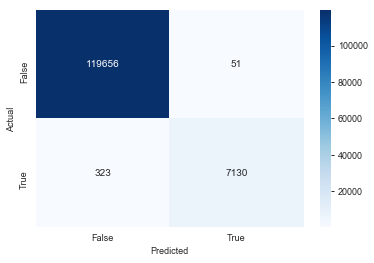

2
we have 35838 edges in complete network
we have 29885 edges in observed network 2
Observed network 2


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.996447 (+/- 0.001680)
accuracy 0.9964465129442841

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    119707
           1       0.99      0.95      0.97      7492

   micro avg       1.00      1.0

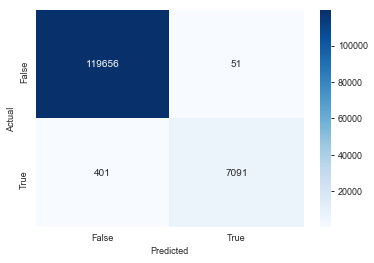

3
we have 35838 edges in complete network
we have 29941 edges in observed network 3
Observed network 3


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.997366 (+/- 0.001225)
accuracy 0.9973661244289994

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    119707
           1       0.99      0.96      0.98      7482

   micro avg       1.00      1.0

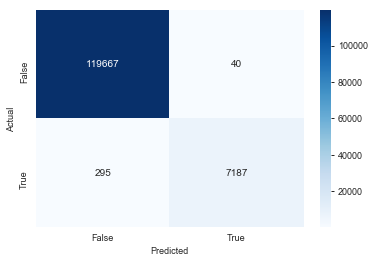

4
we have 35838 edges in complete network
we have 29766 edges in observed network 4
Observed network 4


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.997400 (+/- 0.002079)
accuracy 0.997399638620473

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    119707
           1       0.99      0.96      0.98      7583

   micro avg       1.00      1.00

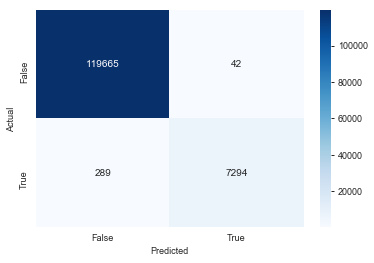

5
we have 35838 edges in complete network
we have 29744 edges in observed network 5
Observed network 5


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating Jaccard coefficients
calculating shortest path length
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'


Accuracy of model on cross validation dataset while training
Accuracy: 0.996635 (+/- 0.002218)
accuracy 0.996634739839503

precision = positive predictive value
recall = sensitivity
f-1 Score = harmonic average of precision and racall
support  = n

              precision    recall  f1-score   support

           0       1.00      1.00      1.00    119707
           1       0.99      0.95      0.97      7772

   micro avg       1.00      1.00

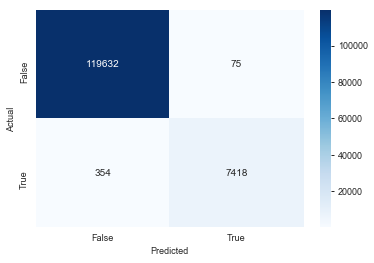

Wall time: 1h 31min 10s


In [23]:
%%time

best_XGB = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.7, gamma=0.1, learning_rate=0.2,
       max_delta_step=0, max_depth=12, min_child_weight=3, missing=None,
       n_estimators=100, n_jobs=1, nthread=None,
       objective='binary:logistic', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, seed=None, silent=True,
       subsample=1)

OutputData = []; SCORES = []; CONFUSION = []; CRs = []
for i in range (1,6):
    print i
    m1 = f.get_observed_network_data(Gc = Gc, i= i, BPnx = BPnx, data_path= data_path, 
                                   virus_df = virus_df, Species_file_name='\IUCN Mammals, Birds, Reptiles, and Amphibians.csv')
    p1, SC, CM, CR = classify.run_classification_model(model_data = m1, cv = 10 , rf = best_XGB, virus_df= virus_df)
    name = 'Prediction_'+str(i)
    p1.rename(index=str, columns={"Prediction": name})
    OutputData.append(p1)
    SCORES.append(SC)
    CONFUSION.append(CM)
    CRs.append(CR)

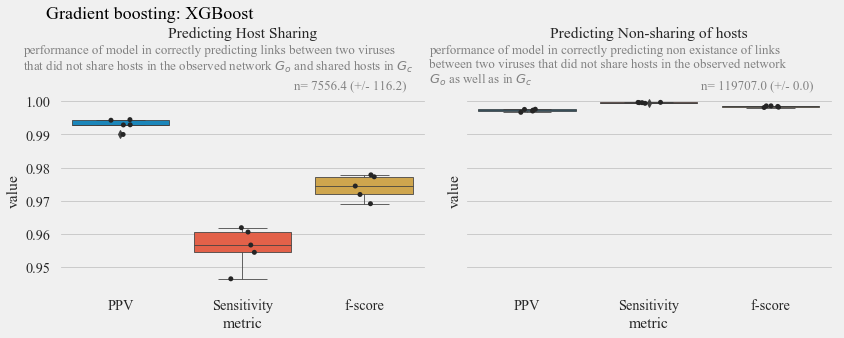

In [24]:
import matplotlib.style as style
style.use('fivethirtyeight')
plt.rcParams['font.family'] = 'Times New Roman'
sns.set_context("notebook", font_scale=1.30, rc={"lines.linewidth": 0.8})
ppv = [c[0][1] for c in CRs]
sensitivity = [c[1][1] for c in CRs]
f_score = [c[2][1] for c in CRs]
metrics = pd.DataFrame({'PPV':ppv, 'Sensitivity': sensitivity, 'f-score': f_score})
m = metrics.stack().reset_index()
m.columns = ['model_iteration', 'metric', 'value']

ppv = [c[0][0] for c in CRs]
sensitivity = [c[1][0] for c in CRs]
f_score = [c[2][0] for c in CRs]
metrics2 = pd.DataFrame({'PPV':ppv, 'Sensitivity': sensitivity, 'f-score': f_score})
m2 = metrics2.stack().reset_index()
m2.columns = ['model_iteration', 'metric', 'value']

fig, (ax1, ax2) = plt.subplots(1,2, figsize = [12,5], sharey= True)
sns.boxplot(x="metric", y="value", data=m, ax= ax1)
sns.stripplot(x="metric", y="value", data=m, jitter= True, color='#252525', ax= ax1)
ax1.set_title('Predicting Host Sharing\n\n\n', horizontalalignment = 'center', loc = 'center')
text1 = 'performance of model in correctly predicting links between two viruses\nthat did not share hosts in the observed network '+ r'$G_o$'+ ' and shared hosts in '+ r'$G_c$'+'\n'
ax1.text(-0.1, 1.02, text1, verticalalignment='bottom', 
         horizontalalignment='left',
         transform=ax1.transAxes,
         color='gray', fontsize=13)
N = [c[3][1] for c in CRs]
mean1 = str(np.mean(N))
std1 = str(np.std(N))
sample1 = ("n= %0.1f (+/- %0.1f)" % (np.mean(N), np.std(N)))
ax1.text(0.95, 1.0, sample1, verticalalignment='bottom', 
         horizontalalignment='right',
         transform=ax1.transAxes,
         color='gray', fontsize=13)

ax1.text(-1.15, 1.35, 'Gradient boosting: XGBoost', verticalalignment='bottom', 
         horizontalalignment='left',
         transform=ax2.transAxes,
         color='k', fontsize=18)

sns.boxplot(x="metric", y="value", data=m2, ax= ax2)
sns.stripplot(x="metric", y="value", data=m2, jitter= True, color='#252525', ax= ax2)
ax2.set_title('Predicting Non-sharing of hosts\n\n\n')
text2 = 'performance of model in correctly predicting non existance of links \nbetween two viruses that did not share hosts in the observed network \n'+ r'$G_o$'+ ' as well as in '+ r'$G_c$'
ax2.text(-0.1, 1.02, text2, verticalalignment='bottom', 
         horizontalalignment='left',
         transform=ax2.transAxes,
         color='gray', fontsize=13)

N2 = [c[3][0] for c in CRs]
mean2 = str(np.mean(N2))
std2 = str(np.std(N2))
sample2 = ("n= %0.1f (+/- %0.1f)" % (np.mean(N2), np.std(N2)))
ax2.text(0.95, 1.0, sample2, verticalalignment='bottom', 
         horizontalalignment='right',
         transform=ax2.transAxes,
         color='gray', fontsize=13)

plt.tight_layout(rect=[0, 0.03, 1, 0.97])
plt.savefig(output_path+'/performance_XGBoost_binary.png', dpi = 500)
plt.show()      

In [26]:
m.pivot_table(index='model_iteration', columns='metric', values='value')

metric,PPV,Sensitivity,f-score
model_iteration,,,
0,0.992898,0.956662,0.974443
1,0.992859,0.946476,0.969113
2,0.994465,0.960572,0.977225
3,0.994275,0.961888,0.977814
4,0.989991,0.954452,0.971896


In [27]:
m.pivot_table(index='model_iteration', columns='metric', values='value').describe()

metric,PPV,Sensitivity,f-score
count,5.000000,5.000000,5.000000
mean,0.992898,0.956010,0.974098
std,0.001789,0.006106,0.003654
min,0.989991,0.946476,0.969113
25%,0.992859,0.954452,0.971896
50%,0.992898,0.956662,0.974443
75%,0.994275,0.960572,0.977225
max,0.994465,0.961888,0.977814


## ROC curve

In [52]:
def run_classification_model_pred(model_data, cv, rf, virus_df):
    from HPnex import functions as f
    predictors = [
        'jaccard', 'betweeness_diff', 'in_same_cluster', 'degree_diff',
        'FamilyMatch', 'PubMed_diff', 'PubMed_Search_ln1', 'PubMed_Search_ln2'
    ]
    # datasets for sklearn
    Y = model_data["label"].values
    X = model_data[list(predictors)].values

    #### Standardize continuous variables
    from sklearn.preprocessing import StandardScaler
    from sklearn  import preprocessing
    from pandas_ml import ConfusionMatrix
    scaler = StandardScaler()
    X_std = scaler.fit_transform(X)
    data_processed = pd.DataFrame(X_std, columns=predictors)
    #data_processed.head()

    ### Encoding categorical variables
    le = preprocessing.LabelEncoder()
    le.fit(virus_df.viral_family.unique())
    model_data['F1'] = le.transform(model_data.ViralFamily1.fillna('Not_Assinged'))
    model_data['F2'] = le.transform(model_data.ViralFamily2.fillna('Not_Assinged'))
    data_processed['F1'] = model_data.F1
    data_processed['F2'] = model_data.F2
    data_processed.fillna(0, inplace=True)
    ### Running cross validation scores and predictions
    from sklearn.model_selection import StratifiedKFold ,cross_val_score, train_test_split, cross_val_predict
    from sklearn.metrics import classification_report, f1_score, accuracy_score, confusion_matrix, precision_recall_fscore_support

    y_pred = cross_val_predict(rf, data_processed, Y, cv=5,method='predict_proba')
    result = pd.DataFrame(y_pred)
    result['Y'] = Y
    return result



In [53]:
%%time
best_XGB = XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
       colsample_bytree=0.7, gamma=0.1, learning_rate=0.2,
       max_delta_step=0, max_depth=12, min_child_weight=3, missing=None,
       n_estimators=100, n_jobs=1, nthread=None,
       objective='binary:logistic', random_state=0, reg_alpha=0,
       reg_lambda=1, scale_pos_weight=1, seed=None, silent=True,
       subsample=1)

RESULT = []
for i in range (1,6):
    print i
    m1 = f.get_observed_network_data(Gc = Gc, i= i, BPnx = BPnx, data_path= data_path, 
                                   virus_df = virus_df, Species_file_name='\IUCN Mammals, Birds, Reptiles, and Amphibians.csv')
    Result = run_classification_model_pred(model_data = m1, cv = 10 , rf = best_XGB, virus_df= virus_df)
    RESULT.append(Result)

1
we have 35838 edges in complete network
we have 29888 edges in observed network 1
Observed network 1


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'

2
we have 35838 edges in complete network
we have 29757 edges in observed network 2
Observed network 2


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'

3
we have 35838 edges in complete network
we have 29811 edges in observed network 3
Observed network 3


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'

4
we have 35838 edges in complete network
we have 29985 edges in observed network 4
Observed network 4


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'

5
we have 35838 edges in complete network
we have 29813 edges in observed network 5
Observed network 5


Loading BokehJS ...


Develop Dataset for the Go

getting Order and Family values for shared hosts

Calculating topographical features for 'Go'

calculating topographical features
calculating shortest path length
calculating Jaccard coefficients
calculating adamic/adar index
calculating Resource coefficients
calculating preferential attachment coefficients
listing neighbors
calculating number of neighbors
calculating difference in betweenness centrality
calculating is nodes are in a same cluster
calculating difference in degree
getting Order and Family values for shared hosts
richness calculations complete
calculating ShannonH index of diversity for shared Orders and Familes of taxa
Matching Virus Families
difference in PubMed hits

Generating model data lables for 'Go'

Wall time: 1h 9min 49s


In [65]:
Re = pd.concat(RESULT, axis=0)
Re.columns = ['Neg', 'Pos', 'Y']

In [66]:
Re.head()

,Neg,Pos,Y
0,0.992897,0.007103,0
1,0.999170,0.000830,0
2,0.987757,0.012243,0
3,0.997823,0.002176,0
4,0.991784,0.008216,0


In [84]:
import matplotlib.style as style
style.use('fivethirtyeight')
plt.rcParams['font.family'] = 'Times New Roman'
sns.set_context("notebook", font_scale=1.30, rc={"lines.linewidth": 0.8})

from sklearn.metrics import roc_curve, auc, precision_recall_curve

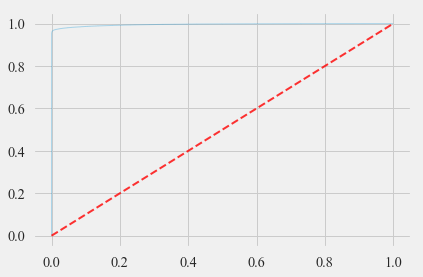

In [85]:
from scipy import interp
tprs = []
aucs = []
mean_fpr = np.linspace(0, 1, 100)

fpr, tpr, thresholds = roc_curve(Re['Y'], Re['Pos'])
tprs.append(interp(mean_fpr, fpr, tpr))
tprs[-1][0] = 0.0
roc_auc = auc(fpr, tpr)
aucs.append(roc_auc)
plt.plot(fpr, tpr, lw=1, alpha=0.3,
         label='ROC fold %d (AUC = %0.2f)' % (1, roc_auc))

i += 1
plt.plot([0, 1], [0, 1], linestyle='--', lw=2, color='r',
     label='Chance', alpha=.8)

In [86]:
p, r, thresholds = precision_recall_curve(Re['Y'], Re['Pos'])

In [87]:
def adjusted_classes(y_scores, t):
    """
    This function adjusts class predictions based on the prediction threshold (t).
    Will only work for binary classification problems.
    """
    return [1 if y >= t else 0 for y in y_scores]

def precision_recall_threshold(p, r, thresholds, t=0.5):
    """
    plots the precision recall curve and shows the current value for each
    by identifying the classifier's threshold (t).
    """
    
    # generate new class predictions based on the adjusted_classes
    # function above and view the resulting confusion matrix.
    y_pred_adj = adjusted_classes(Re['Pos'], t)
    print(pd.DataFrame(confusion_matrix(Re['Y'], y_pred_adj),
                       columns=['pred_neg', 'pred_pos'], 
                       index=['neg', 'pos']))
    
    # plot the curve
    plt.figure(figsize=(8,8))
    plt.title("Precision and Recall curve ^ = current threshold")
    plt.step(r, p, color='b', alpha=0.2,
             where='post')
    plt.fill_between(r, p, step='post', alpha=0.2,
                     color='b')
    plt.ylim([0.5, 1.01]);
    plt.xlim([0.5, 1.01]);
    plt.xlabel('Recall');
    plt.ylabel('Precision');
    
    # plot the current threshold on the line
    close_default_clf = np.argmin(np.abs(thresholds - t))
    plt.plot(r[close_default_clf], p[close_default_clf], '^', c='k',
            markersize=15)

     pred_neg  pred_pos
neg    598227       308
pos      1651     36177


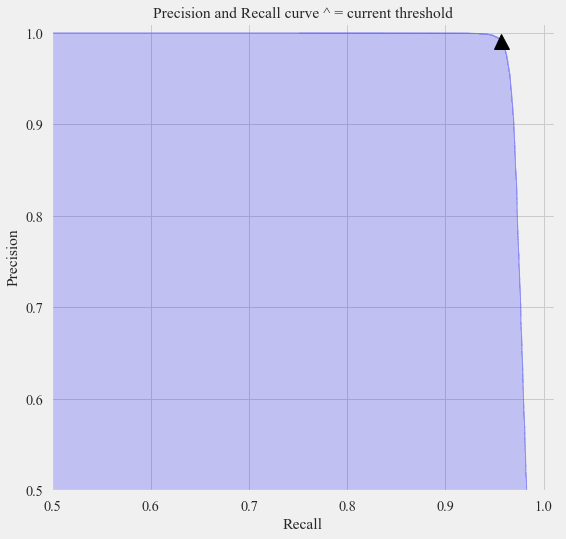

In [91]:
precision_recall_threshold(p, r, thresholds, 0.50)

In [94]:
def plot_precision_recall_vs_threshold(precisions, recalls, thresholds):
    """
    Modified from:
    Hands-On Machine learning with Scikit-Learn
    and TensorFlow; p.89
    """
    plt.figure(figsize=(8, 8))
    plt.title("Precision and Recall Scores as a function of the decision threshold")
    plt.plot(thresholds, precisions[:-1], "b--", label="Precision (PPV)")
    plt.plot(thresholds, recalls[:-1], "g-", label="Recall (Sensitivity)")
    plt.ylabel("Score")
    plt.xlabel("Decision Threshold")
    plt.legend(loc='best')

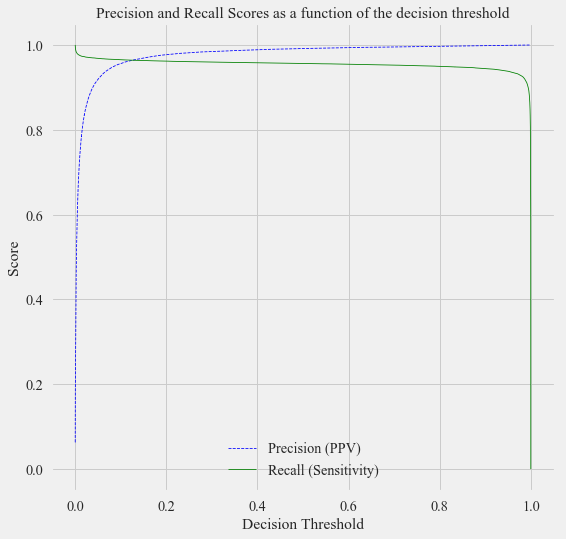

In [95]:
plot_precision_recall_vs_threshold(p, r, thresholds)